In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!git clone https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 88096, done.
remote: Counting objects: 100% (1808/1808), done.
remote: Compressing objects: 100% (753/753), done.
remote: Total 88096 (delta 1178), reused 1613 (delta 1037), pack-reused 86288
Receiving objects: 100% (88096/88096), 603.00 MiB | 40.91 MiB/s, done.
Resolving deltas: 100% (63076/63076), done.


In [ ]:
!cd models/research/ && protoc object_detection/protos/*.proto --python_out=.

In [ ]:
!cd models/research && \
 cp object_detection/packages/tf2/setup.py . && \
 python -m pip install .

In [ ]:
import cv2
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import pathlib
import tensorflow as tf
from tensorflow.keras.utils import plot_model
from tensorflow.keras.models import Model
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
import time
import numpy as np
import os
from tensorflow.keras.models import load_model
from PIL import Image, ImageDraw
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Input, Dense, Flatten, Conv2D, MaxPool2D, BatchNormalization, Dropout

In [1]:
!ls -lh

total 4.0K
drwxr-xr-x 1 root root 4.0K Mar 28 23:00 sample_data


In [ ]:
from tqdm import tqdm

In [ ]:
url = "http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz"

In [ ]:
PATH_TO_MODEL_DIR = tf.keras.utils.get_file(
    fname = "ssd_resnet50_v1_fpn_640x640_coco17_tpu-8",
    origin = url,
    untar = True)

244817203/244817203 [==============================] - 6s 0us/step


In [ ]:
PATH_TO_CFG = PATH_TO_MODEL_DIR + "/pipeline.config"
PATH_TO_CKPT = PATH_TO_MODEL_DIR + "/checkpoint"

In [ ]:
from object_detection.builders import model_builder
from object_detection.utils import config_util

configs = config_util.get_configs_from_pipeline_file(PATH_TO_CFG)
model_config = configs['model']
detection_model = model_builder.build(model_config=model_config, is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(model=detection_model)
ckpt.restore(os.path.join(PATH_TO_CKPT, 'ckpt-0')).expect_partial()

In [ ]:
os.listdir(PATH_TO_MODEL_DIR + "/checkpoint")

['ckpt-0.index', 'ckpt-0.data-00000-of-00001', 'checkpoint']

In [ ]:
dir_path = '/content/drive/MyDrive/EMOTIC_YO/emotic/'

In [ ]:
PATH_TO_CKPT

'/root/.keras/datasets/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint'

In [ ]:
# label_map = label_map_util.load_labelmap(label_map_path)

In [ ]:
PATH_TO_MODEL_DIR

'/root/.keras/datasets/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8'

In [ ]:
PATH_TO_SAVED_MODEL = PATH_TO_MODEL_DIR + "/saved_model"
print("Loading model...",end='')
start_time = time.time()
model = tf.saved_model.load(PATH_TO_SAVED_MODEL)
end_time = time.time()
elapsed_time = end_time - start_time
print(f'took {elapsed_time} seconds')

Loading model...took 21.97743272781372 seconds


In [ ]:
# category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

In [ ]:
import pandas as pd
import numpy as np

df_train = pd.read_csv("/content/drive/MyDrive/balanced_dataset_annots/train_rem.csv")
df_test = pd.read_csv('/content/drive/MyDrive/balanced_dataset_annots/test_rem.csv')

In [ ]:
df_train.head()

,File_Name,File_Path,Img_Height,Img_Width,X_Min,X_Max,Y_Min,Y_Max,Affection,Anger,...,Excitement,Fatigue,Happiness,Peace,Pleasure,Sadness,Sensitivity,Surprise,Sympathy,Label_Names
0,COCO_train2014_000000196197.jpg,/content/drive/MyDrive/EMOTIC_YO/emotic/mscoco...,480,640,149,258,122,393,0,0,...,0,0,0,0,0,0,0,0,0,Anticipation
1,COCO_val2014_000000544629.jpg,/content/drive/MyDrive/EMOTIC_YO/emotic/mscoco...,640,427,158,280,116,333,0,0,...,0,0,0,0,0,0,0,0,0,Anticipation
2,COCO_train2014_000000332322.jpg,/content/drive/MyDrive/EMOTIC_YO/emotic/mscoco...,375,640,167,374,44,252,0,0,...,0,0,0,0,0,0,0,0,0,Anticipation
3,COCO_train2014_000000247422.jpg,/content/drive/MyDrive/EMOTIC_YO/emotic/mscoco...,242,500,6,82,28,230,0,0,...,0,0,0,0,0,0,0,0,0,Anticipation
4,COCO_train2014_000000287038.jpg,/content/drive/MyDrive/EMOTIC_YO/emotic/mscoco...,427,640,266,464,115,268,0,0,...,0,0,0,0,0,0,0,0,0,Anticipation


In [ ]:
cols = list(df_train.columns[8:8+19])

In [ ]:
label_map_path = "/content/label_map.pbtxt"
# label_map_path = '/root/.keras/datasets/emotic_label_map.pbtxt'

pbtxt_content = ""

for i, class_name in enumerate(cols):
    pbtxt_content = (
        pbtxt_content
        + "item {{\n    id: {0}\n    name: '{1}'\n}}\n\n".format(i + 1, class_name)
    )

pbtxt_content = pbtxt_content.strip()
with open(label_map_path, "w") as f:
    f.write(pbtxt_content)
    print('Successfully created label_map.pbtxt ')

Successfully created label_map.pbtxt 


In [ ]:
df_test.head()

,File_Name,File_Path,Img_Height,Img_Width,X_Min,X_Max,Y_Min,Y_Max,Affection,Anger,...,Excitement,Fatigue,Happiness,Peace,Pleasure,Sadness,Sensitivity,Surprise,Sympathy,Label_Names
0,COCO_train2014_000000313020.jpg,/content/drive/MyDrive/EMOTIC_YO/emotic/mscoco...,427,640,439,622,166,384,0,0,...,0,0,0,0,0,0,0,0,0,Anticipation
1,COCO_train2014_000000256040.jpg,/content/drive/MyDrive/EMOTIC_YO/emotic/mscoco...,458,640,256,380,118,306,0,0,...,0,0,0,0,0,0,0,0,0,Anticipation
2,COCO_train2014_000000252084.jpg,/content/drive/MyDrive/EMOTIC_YO/emotic/mscoco...,427,640,403,552,115,406,0,0,...,0,0,0,0,0,0,0,0,0,Anticipation
3,COCO_train2014_000000357184.jpg,/content/drive/MyDrive/EMOTIC_YO/emotic/mscoco...,333,500,160,338,48,286,0,0,...,0,0,0,0,0,0,0,0,0,Anticipation
4,COCO_train2014_000000355072.jpg,/content/drive/MyDrive/EMOTIC_YO/emotic/mscoco...,480,640,288,465,156,420,0,0,...,0,0,0,0,0,0,0,0,0,Anticipation


In [ ]:
def load_imgpath(df,i):
  imgpath = df.iloc[i].values[1]
  return imgpath

def load_img(df,i,random=False):
  if random:
    i = np.random.choice(len(df))
  img_path = load_imgpath(df,i)
  img = cv2.imread(img_path)
  img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
  return img,i

def get_labels_(df,i):
  class_text = df.iloc[i].values[-1]
  classes = cols.index(class_text)
  return classes,class_text

def plot_bbox(i,df,img):
  nimg = img.copy()
  x1,x2,y1,y2 = df.iloc[i].values[4:8]
  bbox_body = cv2.rectangle(nimg,(x1,y1),(x2,y2),(255,0,0),2)
  return bbox_body

%matplotlib inline
def get_image_labels(df,i,random):
  timg,i = load_img(df,i,random)
  bbox_body  = plot_bbox(i,df,timg)
  _, label = get_labels_(df,i)
  return timg,label,bbox_body

In [ ]:
df_train.head()

,File_Name,File_Path,Img_Height,Img_Width,X_Min,X_Max,Y_Min,Y_Max,Affection,Anger,...,Excitement,Fatigue,Happiness,Peace,Pleasure,Sadness,Sensitivity,Surprise,Sympathy,Label_Names
0,COCO_train2014_000000196197.jpg,/content/drive/MyDrive/EMOTIC_YO/emotic/mscoco...,480,640,149,258,122,393,0,0,...,0,0,0,0,0,0,0,0,0,Anticipation
1,COCO_val2014_000000544629.jpg,/content/drive/MyDrive/EMOTIC_YO/emotic/mscoco...,640,427,158,280,116,333,0,0,...,0,0,0,0,0,0,0,0,0,Anticipation
2,COCO_train2014_000000332322.jpg,/content/drive/MyDrive/EMOTIC_YO/emotic/mscoco...,375,640,167,374,44,252,0,0,...,0,0,0,0,0,0,0,0,0,Anticipation
3,COCO_train2014_000000247422.jpg,/content/drive/MyDrive/EMOTIC_YO/emotic/mscoco...,242,500,6,82,28,230,0,0,...,0,0,0,0,0,0,0,0,0,Anticipation
4,COCO_train2014_000000287038.jpg,/content/drive/MyDrive/EMOTIC_YO/emotic/mscoco...,427,640,266,464,115,268,0,0,...,0,0,0,0,0,0,0,0,0,Anticipation


In [ ]:
df_train.shape

(950, 28)

In [ ]:
df_train.iloc[452]

File_Name                            COCO_train2014_000000275718.jpg
File_Path          /content/drive/MyDrive/EMOTIC_YO/emotic/mscoco...
Img_Height                                                       480
Img_Width                                                        640
X_Min                                                             12
X_Max                                                            296
Y_Min                                                             88
Y_Max                                                            372
Affection                                                          0
Anger                                                              0
Annoyance                                                          0
Anticipation                                                       0
Confidence                                                         0
Disconnection                                                      0
Disquietment                      

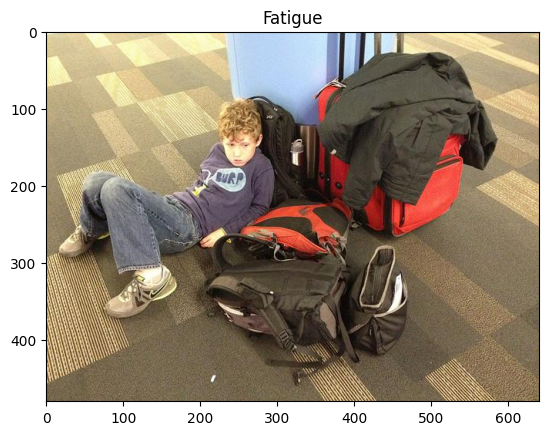

In [ ]:
%matplotlib inline
img,i = load_img(df_train,452,random=False)
indx,label = get_labels_(df_train,i)
plt.imshow(img)
plt.title(label)
plt.show()
# print(cols[indx])

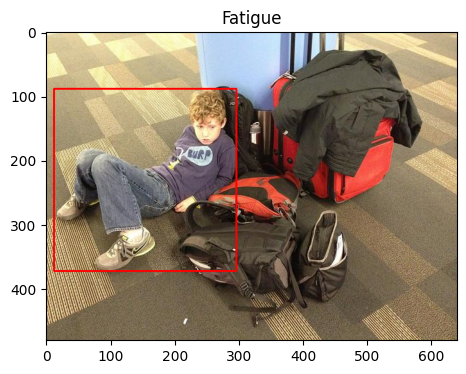

In [ ]:
bbox_body  = plot_bbox(i,df_train,img)
plt.figure(figsize=(16,4))
plt.title(label)
plt.imshow(bbox_body)
plt.show()

# TEST THE LOADED MODEL (its trained on coco)

In [ ]:
input_tensor = tf.convert_to_tensor(img)
inp_tens = input_tensor[tf.newaxis,...]
det = model.signatures['serving_default'](inp_tens)

In [ ]:
num_dets = int(det.pop('num_detections'))
det = {key: value[0, :num_dets].numpy()
           for key,value in det.items()}
det['num_detections'] = num_dets

In [ ]:
img_with_dets = img.copy()

In [ ]:
det

{'raw_detection_scores': array([[0.00397017, 0.00478915, 0.00334844, ..., 0.00258197, 0.00405723,
         0.00326648],
        [0.00383891, 0.00309957, 0.0030559 , ..., 0.00212381, 0.00373866,
         0.00260991],
        [0.00374477, 0.00517378, 0.00381454, ..., 0.00309993, 0.00390825,
         0.003064  ],
        ...,
        [0.00353274, 0.00437995, 0.00272784, ..., 0.00514522, 0.00464265,
         0.0031153 ],
        [0.00358517, 0.00854825, 0.00382226, ..., 0.00644098, 0.00507702,
         0.00352479],
        [0.00351741, 0.0050195 , 0.00316176, ..., 0.00542198, 0.00453659,
         0.00269918]], dtype=float32),
 'detection_multiclass_scores': array([[0.00219355, 0.6302453 , 0.0120409 , ..., 0.00801683, 0.00417651,
         0.0051024 ],
        [0.00197249, 0.58228254, 0.01586168, ..., 0.00976932, 0.00410405,
         0.00613583],
        [0.00233965, 0.443695  , 0.01886541, ..., 0.00897199, 0.00484489,
         0.0041456 ],
        ...,
        [0.00187515, 0.07601073, 0.138

In [ ]:
def plot_bbox(img,bbox):
  nimg = img.copy()
  y1,x1,y2,x2 = bbox
  x1 = int(x1*img.shape[1])
  x2 = int(x2*img.shape[1])
  y1 = int(y1*img.shape[0])
  y2 = int(y2*img.shape[0])
  bbox_body = cv2.rectangle(nimg,(x1,y1),(x2,y2),(255,0,0),2)
  return bbox_body

In [ ]:
for i in range(det['num_detections']):
  bbox = det['detection_boxes'][i]
  print(category_index[det['detection_classes'][i]]['name'])
  img_with_dets =  plot_bbox(img_with_dets,bbox)
cv2_imshow(img_with_dets)

Affection
Affection
Affection
Disconnection
Annoyance
Confidence
Anticipation
Fatigue
Disapproval
Annoyance
Annoyance
Affection
Disconnection
Confidence
Annoyance
Disconnection
Disconnection
Fatigue
Affection
Fatigue


KeyError: ignored

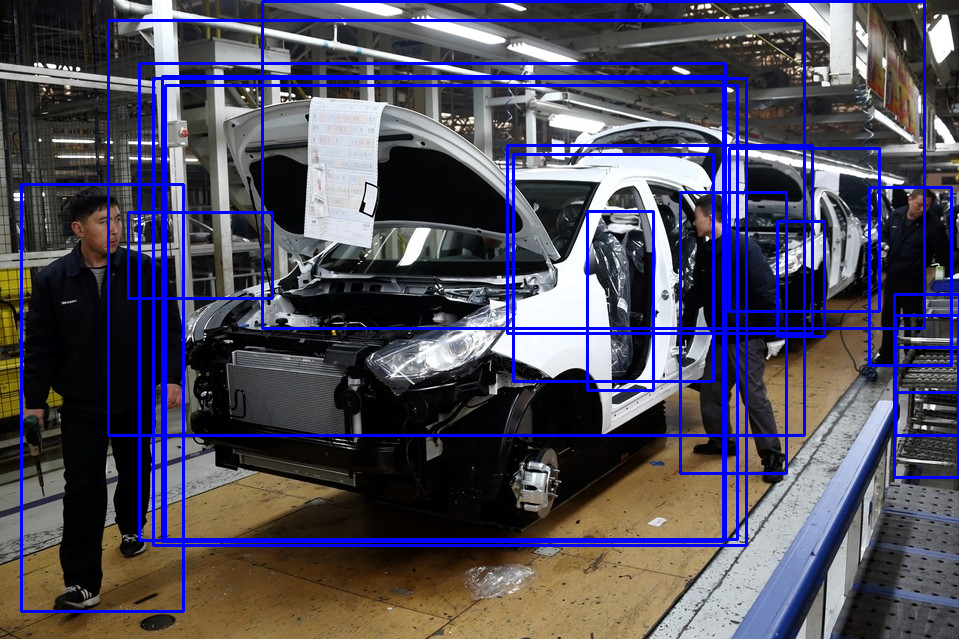

In [ ]:
cv2_imshow(img_with_dets)

# FUNCTIONS TO CONVERT OUR ANNOTATIONS,LABELS, IMAGES TO BYTES

In [ ]:
def image_feature(value):
    """Returns a bytes_list from a string / byte."""
    return tf.train.Feature(
        bytes_list=tf.train.BytesList(value=[tf.io.encode_jpeg(value).numpy()])
    )

def bytes_feature(value):
    """Returns a bytes_list from a string / byte."""
    return tf.train.Feature(bytes_list=tf.train.BytesList(value=[value.encode()]))


def float_feature(value):
    """Returns a float_list from a float / double."""
    return tf.train.Feature(float_list=tf.train.FloatList(value=[value]))


def int64_feature(value):
    """Returns an int64_list from a bool / enum / int / uint."""
    return tf.train.Feature(int64_list=tf.train.Int64List(value=[value]))

def int64_feature_list(value):
    """Returns an int64_list from a bool / enum / int / uint."""
    return tf.train.Feature(int64_list=tf.train.Int64List(value=value))

def float_feature_list(value):
    """Returns a list of float_list from a float / double."""
    return tf.train.Feature(float_list=tf.train.FloatList(value=value))

In [ ]:
def get_labels_(info_dict):
  classes = info_dict[b'workers'][0][b'labels']
  class_text = [cat[lb-1].encode('utf8') for lb in classes]
  return classes,class_text

In [ ]:
# def get_cat_id(info_dict):
#   lbls = info_dict[b'workers'][0][b'labels']
#   return lbls

In [ ]:
def load_img_path_(info_dict):
  img_name = str(info_dict[b'filename'])[2:-1]
  folder_name = str(info_dict[b'folder'])[2:-1]
  img_path = dir_path + folder_name + '/' + img_name
  return img_path

In [ ]:
from object_detection.utils import dataset_util
import io
from PIL import Image

In [ ]:
def get_coord(info_dict):
  x1,y1,x2,y2 = info_dict[b'body_bbox']
  w,h = info_dict[b'image_size']
  return [w,h, x1/w, y1/h, x2/w, y2/h]

In [ ]:
def create_example(path, example):
  with tf.io.gfile.GFile(os.path.join('{}'.format(path)), 'rb') as fid:
    encoded_jpg = fid.read()
  encoded_jpg_io = io.BytesIO(encoded_jpg)
  image = Image.open(encoded_jpg_io)
  width,height , xmins, ymins , xmaxs , ymaxs = get_coord(example)
  classes,classes_text = get_labels(example)
  filename = example[b"filename"]
  image_format = b'jpg'

  feature={
          'image/height': dataset_util.int64_feature(height),
          'image/width': dataset_util.int64_feature(width),
          'image/filename': dataset_util.bytes_feature(filename),
          'image/source_id': dataset_util.bytes_feature(filename),
          'image/encoded': dataset_util.bytes_feature(encoded_jpg),
          'image/format': dataset_util.bytes_feature(image_format),
          'image/object/bbox/xmin': float_feature(xmins),
          'image/object/bbox/xmax': float_feature(xmaxs),
          'image/object/bbox/ymin': float_feature(ymins),
          'image/object/bbox/ymax': float_feature(ymaxs),
          'image/object/class/text': dataset_util.bytes_list_feature(classes_text),
          'image/object/class/label': dataset_util.int64_list_feature(classes)}

  return tf.train.Example(features=tf.train.Features(feature=feature))

In [ ]:
# def create_example(image, path, example):
#     feature = {
#         "image": image_feature(image),
#         "path": bytes_feature(path),
#         "bbox": float_feature_list(example[b"body_bbox"]),
#         "label": int64_feature_list(get_cat_id(example)),
#         "image_id":  bytes_feature(str(example[b"filename"])[2:-1]),
#     }
#     return tf.train.Example(features=tf.train.Features(feature=feature))

In [ ]:
# !rm -rf 'train'
# !rm -rf 'test'

In [ ]:
img.shape

(639, 959, 3)

In [ ]:
# create_example(load_img_path(train_ds,i)[0], train_ds[i])

In [ ]:
# def parse_tfrecord_fn(example):
#     feature_description = {
#         "image": tf.io.FixedLenFeature([], tf.string),
#         "path": tf.io.FixedLenFeature([], tf.string),
#         "bbox": tf.io.VarLenFeature(tf.float32),
#         "label": tf.io.VarLenFeature(tf.int64),
#         "image_id": tf.io.FixedLenFeature([], tf.string),
#     }
#     example = tf.io.parse_single_example(example, feature_description)
#     example["image"] = tf.io.decode_jpeg(example["image"], channels=3)
#     example["bbox"] = tf.sparse.to_dense(example["bbox"])
#     example["label"] = tf.sparse.to_dense(example["label"])
#     return example

In [ ]:
#  77%|███████▋  | 18208/23706 [3:30:30<1:03:33,  1.44it/s]

In [ ]:
# for tfrec_num in tqdm(range(num_tfrecords)):
#     samples = train_ds[(tfrec_num * num_samples) : ((tfrec_num + 1) * num_samples)]
#     with tf.io.TFRecordWriter(tfrecords_dir + "/" + "train.tfrecord") as writer:
#         for sample in samples:
#             image_path =  load_img_path_(sample)
#             image = tf.io.decode_jpeg(tf.io.read_file(image_path))
#             if image.shape[-1] > 3: continue
#             example = create_example(image, image_path, sample)
#             writer.write(example.SerializeToString())

# writer.close()
# print('Successfully created the TFRecords training')

100%|██████████| 23706/23706 [2:00:14<00:00,  3.29it/s]

Successfully created the TFRecords training


In [ ]:
# with tf.io.TFRecordWriter(tfrecords_dir + "/" + "train.tfrecord") as writer:
#   for tfrec_num in tqdm(range(num_tfrecords)):
#     sample = train_ds[tfrec_num]
#     image_path =  load_img_path_(sample)
#     example = create_example(image_path, sample)
#     writer.write(example.SerializeToString())

# print('Successfully created the TFRecords training')

# CODE TO GENERATE THE TFRECORD FILES (we have already saved it so no need to run)

## Training tfrecord

In [ ]:
# tfrecords_dir = "/content/drive/MyDrive/EMOTIC_YO/training"
tfrecords_dir = "/content/training"

num_samples = 1
num_tfrecords = len(train_ds) // num_samples
if len(train_ds) % num_samples:
    num_tfrecords += 1  # add one record if there are any remaining samples

if not os.path.exists(tfrecords_dir):
    os.makedirs(tfrecords_dir)

In [ ]:
with tf.io.TFRecordWriter(tfrecords_dir + "/" + "train.tfrecord") as writer:
  for tfrec_num in tqdm(range(num_tfrecords)):
    sample = train_ds[(tfrec_num * num_samples) : ((tfrec_num + 1) * num_samples)][0]
    image_path =  load_img_path_(sample)
    example = create_example(image_path, sample)
    writer.write(example.SerializeToString())

print('Successfully created the TFRecords training')

100%|██████████| 23706/23706 [1:08:22<00:00,  5.78it/s]

Successfully created the TFRecords training


In [ ]:
# with tf.io.TFRecordWriter(tfrecords_dir + "/" + "train.tfrecord") as writer:
#   for tfrec_num in tqdm(range(num_tfrecords)):
#     samples = train_ds[(tfrec_num * num_samples) : ((tfrec_num + 1) * num_samples)]
#     for sample in samples:
#         image_path =  load_img_path_(sample)
#         image = tf.io.decode_jpeg(tf.io.read_file(image_path))
#         if image.shape[-1] > 3: continue
#         example = create_example(image, image_path, sample)
#         writer.write(example.SerializeToString())

# print('Successfully created the TFRecords training')

100%|██████████| 23706/23706 [07:39<00:00, 51.59it/s]

Successfully created the TFRecords training


In [ ]:
# for tfrec_num in tqdm(range(18208 ,num_tfrecords)):
#     samples = train_ds[(tfrec_num * num_samples) : ((tfrec_num + 1) * num_samples)]
#     i=0
#     with tf.io.TFRecordWriter(
#         tfrecords_dir + "/file_%.2i-%i.tfrec" % (tfrec_num, len(samples))
#     ) as writer:
#         for sample in samples:
#             image_path =  load_img_path_(sample)
#             image = tf.io.decode_jpeg(tf.io.read_file(image_path))
#             if image.shape[-1] > 3: continue
#             example = create_example(image, image_path, sample)
#             writer.write(example.SerializeToString())
#             i+=1

100%|██████████| 5498/5498 [17:21<00:00,  5.28it/s]


bbox: [ 28.   1. 579. 398.]
label: [ 1  6 17]
image_id: b'007eear5kx5qhbzewz.jpg'
path: b'/content/drive/MyDrive/EMOTIC_YO/emotic/emodb_small/images/007eear5kx5qhbzewz.jpg'
Image shape: (400, 580, 3)


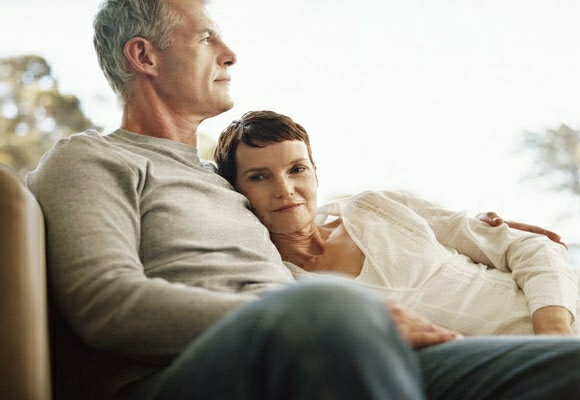

In [ ]:
# raw_dataset = tf.data.TFRecordDataset(f"{tfrecords_dir}/file_01-{num_samples}.tfrec")
# parsed_dataset = raw_dataset.map(parse_tfrecord_fn)

# for features in parsed_dataset.take(1):
#     for key in features.keys():
#         if key != "image":
#             print(f"{key}: {features[key]}")

#     print(f"Image shape: {features['image'].shape}")
#     plt.figure(figsize=(7, 7))
#     # plt.imshow(features["image"].numpy())
#     # plt.show()
#     cv2_imshow(cv2.cvtColor(features["image"].numpy(),cv2.COLOR_BGR2RGB))

bbox: [215. 111. 580. 352.]
label: [ 1 20 17]
image_id: b'007eear5kx5qhbzewz.jpg'
path: b'/content/drive/MyDrive/EMOTIC_YO/emotic/emodb_small/images/007eear5kx5qhbzewz.jpg'
Image shape: (400, 580, 3)


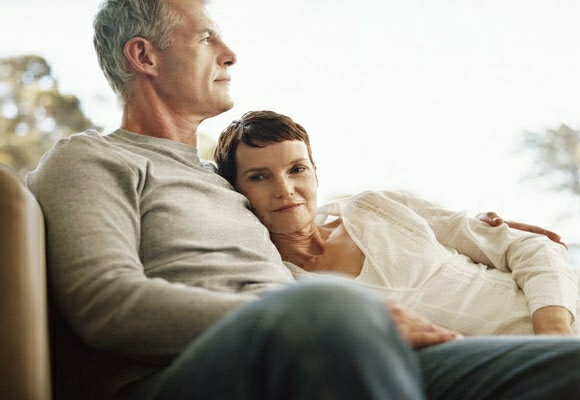

In [ ]:
# raw_dataset = tf.data.TFRecordDataset("/content/training/train.tfrecord")
# parsed_dataset = raw_dataset.map(parse_tfrecord_fn)

# for features in parsed_dataset.take(1):
#     for key in features.keys():
#         if key != "image":
#             print(f"{key}: {features[key]}")

#     print(f"Image shape: {features['image'].shape}")
#     plt.figure(figsize=(7, 7))
#     # plt.imshow(features["image"].numpy())
#     # plt.show()
#     cv2_imshow(cv2.cvtColor(features["image"].numpy(),cv2.COLOR_BGR2RGB))

In [ ]:
def count_tfrecord_examples(
        tfrecords_dir: str,
) -> int:
    """
    Counts the total number of examples in a collection of TFRecord files.

    :param tfrecords_dir: directory that is assumed to contain only TFRecord files
    :return: the total number of examples in the collection of TFRecord files
        found in the specified directory
    """

    count = 0
    for file_name in os.listdir(tfrecords_dir):
        tfrecord_path = os.path.join(tfrecords_dir, file_name)
        count += sum(1 for _ in tf.data.TFRecordDataset(tfrecord_path))

    return count

In [ ]:
tf.compat.v1.enable_eager_execution
sum(1 for _ in tf.data.TFRecordDataset("/content/training/train.tfrecord"))

23706

In [ ]:
len(train_ds)

23706

In [ ]:
# !mv "/content/training/" "/content/drive/MyDrive/EMOTIC_YO"

In [ ]:
# !rm -rf "/content/drive/MyDrive/EMOTIC_YO/test"

In [ ]:
# def create_example(image, path, example):
#     feature = {
#         "image": image_feature(image),
#         "path": bytes_feature(path),
#         "bbox": float_feature_list(example[b"body_bbox"]),
#         "label": int64_feature_list(get_cat_id(example)),
#         "image_id":  bytes_feature(str(example[b"filename"])[2:-1]),
#     }
#     return tf.train.Example(features=tf.train.Features(feature=feature))

In [ ]:
# def parse_tfrecord_fn(example):
#     feature_description = {
#         "image": tf.io.FixedLenFeature([], tf.string),
#         "path": tf.io.FixedLenFeature([], tf.string),
#         "bbox": tf.io.VarLenFeature(tf.float32),
#         "label": tf.io.VarLenFeature(tf.int64),
#         "image_id": tf.io.FixedLenFeature([], tf.string),
#     }
#     example = tf.io.parse_single_example(example, feature_description)
#     example["image"] = tf.io.decode_jpeg(example["image"], channels=3)
#     example["bbox"] = tf.sparse.to_dense(example["bbox"])
#     example["label"] = tf.sparse.to_dense(example["label"])
#     return example

In [ ]:
# with tf.io.TFRecordWriter(tfrecords_dir_test + "/" + "test.tfrecord") as writer:
#   for tfrec_num in tqdm(range(num_tfrecords)):
#     samples = test_ds[(tfrec_num * num_samples) : ((tfrec_num + 1) * num_samples)]
#     for sample in samples:
#         image_path =  load_img_path_(sample)
#         image = tf.io.decode_jpeg(tf.io.read_file(image_path))
#         if image.shape[-1] > 3: continue
#         example = create_example(image, image_path, sample)
#         writer.write(example.SerializeToString())

# print('Successfully created the TFRecords training')

100%|██████████| 7280/7280 [33:53<00:00,  3.58it/s]

Successfully created the TFRecords training


## TESTING TFRECORD

In [ ]:
tfrecords_dir_test = "/content/testing"

num_samples = 1
num_tfrecords = len(test_ds) // num_samples
if len(test_ds) % num_samples:
    num_tfrecords += 1  # add one record if there are any remaining samples

if not os.path.exists(tfrecords_dir_test):
    os.makedirs(tfrecords_dir_test)

In [ ]:
with tf.io.TFRecordWriter(tfrecords_dir_test  + "/" + "test.tfrecord") as writer:
  for tfrec_num in tqdm(range(num_tfrecords)):
    sample = test_ds[tfrec_num]
    image_path =  load_img_path_(sample)
    example = create_example(image_path, sample)
    writer.write(example.SerializeToString())

print('Successfully created the TFRecords testing')

100%|██████████| 7280/7280 [31:53<00:00,  3.81it/s]

Successfully created the TFRecords testing


In [ ]:
# for tfrec_num in tqdm(range(num_tfrecords)):
#     samples = test_ds[(tfrec_num * num_samples) : ((tfrec_num + 1) * num_samples)]
#     i=0
#     with tf.io.TFRecordWriter(
#         tfrecords_dir + "/file_%.2i-%i.tfrec" % (tfrec_num, len(samples))
#     ) as writer:
#         for sample in samples:
#             image_path =  load_img_path(test_ds,i)[0]
#             image = tf.io.decode_jpeg(tf.io.read_file(image_path))
#             example = create_example(image, image_path, sample)
#             writer.write(example.SerializeToString())
#             i+=1

100%|██████████| 7280/7280 [22:34<00:00,  5.38it/s]


In [ ]:
PATH_TO_CKPT

'/root/.keras/datasets/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint'

In [ ]:
tf.compat.v1.enable_eager_execution
sum(1 for _ in tf.data.TFRecordDataset("/content/testing/test.tfrecord"))

7280

In [ ]:
len(test_ds)

7280

In [ ]:
# !mv "/content/testing/" "/content/drive/MyDrive/EMOTIC_YO"

In [ ]:
# pip install -U tensorboard

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 13.7 MB/s eta 0:00:00
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.13.0
    Uninstalling tensorboard-2.13.0:
      Successfully uninstalled tensorboard-2.13.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.13.0 requires tensorboard<2.14,>=2.13, but you have tensorboard 2.14.0 which is incompatible.


# Training our model

In [ ]:
!ps -e | grep 'tensorboard' | awk '{print $1}'

2594


In [ ]:
!kill 2594

In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/drive/MyDrive/pretrained_models_BS8' --load_fast=true

<IPython.core.display.Javascript object>

In [ ]:
%cd /content/models/research/object_detection

/content/models/research/object_detection


In [ ]:
!pip install tensorflow==2.13.0

In [ ]:
!python model_main_tf2.py --pipeline_config_path=/content/drive/MyDrive/balanced_dataset_annots/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.config --model_dir=/content/drive/MyDrive/pretrained_models_BS8 --alsologtostderr

2023-10-22 18:08:36.478145: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
2023-10-22 18:08:43.252827: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:47] Overriding orig_value setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I1022 18:08:43.254199 136109888586880 mirrored_strategy.py:419] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: None
I1022 18:08:43.758178 136109888586880 config_util.py:552] Maybe overwriting train_steps: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I1022 18:08:43.758442 136109888586880 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W1022 18:08:44.039417 136109888586880 dep

# GET the evaluation metrics


In [ ]:
!python model_main_tf2.py --pipeline_config_path=/content/drive/MyDrive/balanced_dataset_annots/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.config --model_dir=/content/drive/MyDrive/pretrained_models_BS8 --checkpoint_dir=/content/drive/MyDrive/pretrained_models_BS8 --alsologtostderr

2023-10-22 20:33:45.961685: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
W1022 20:33:53.765945 134584762086528 model_lib_v2.py:1089] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I1022 20:33:53.766220 134584762086528 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I1022 20:33:53.766363 134584762086528 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I1022 20:33:53.766468 134584762086528 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W1022 20:33:53.766617 134584762086528 model_lib_v2.py:1106] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
2023-10-22 20:33:56.558974: W tensorflow/core/common_runtime/gpu/gpu_bfc_alloca

# Extracting the newly trained inference graph, which will be later used to perform the object detection.

In [ ]:
!python exporter_main_v2.py --trained_checkpoint_dir=/content/drive/MyDrive/pretrained_models_BS8 --pipeline_config_path=/content/drive/MyDrive/balanced_dataset_annots/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.config --output_directory /content/drive/MyDrive/pretrained_models_BS8/data/inference_graph

2023-10-22 21:39:11.770225: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
2023-10-22 21:39:15.256501: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:47] Overriding orig_value setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W1022 21:39:15.743781 134653646083200 deprecation.py:641] From /usr/local/lib/python3.10/dist-packages/tensorflow/python/autograph/impl/api.py:459: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with back_prop=False is deprecated and will be removed in a future version.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back

# Load the saved model

In [ ]:
IMAGE_SIZE = (12, 8) # Output display size as you want
import matplotlib.pyplot as plt
PATH_TO_SAVED_MODEL="/content/drive/MyDrive/pretrained_models_BS8/data/inference_graph/saved_model"
print('Loading model...', end='')
# Load saved model and build the detection function
detect_fn=tf.saved_model.load(PATH_TO_SAVED_MODEL)
print('Done!')

Loading model...Done!


In [ ]:
category_index = label_map_util.create_category_index_from_labelmap("/content/label_map.pbtxt",use_display_name=True)

In [ ]:
len(df_test)

171

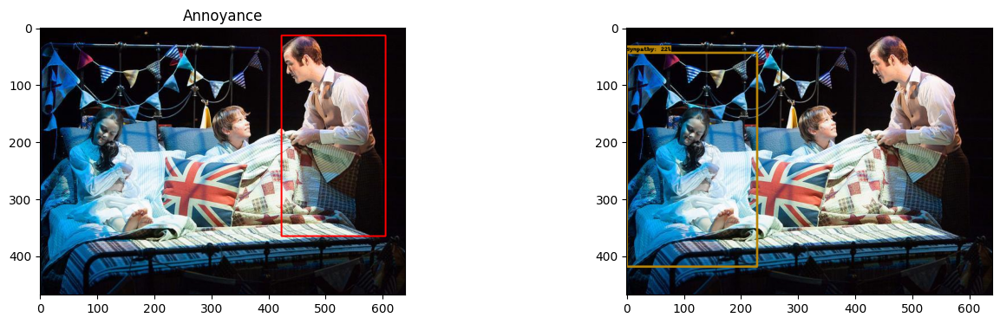

In [ ]:
timg,labels,bbox_body = get_image_labels(df_test,i,True)
input_tensor = tf.convert_to_tensor(timg)
# The model expects a batch of images, so add an axis with `tf.newaxis`.
input_tensor = input_tensor[tf.newaxis, ...]

detections = detect_fn(input_tensor)

image_np_with_detections = timg.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      detections['detection_classes'][0].numpy().astype(np.int32),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=2,
      min_score_thresh=0.2, # Adjust this value to set the minimum probability boxes to be classified as True
      agnostic_mode=False)

%matplotlib inline
plt.figure(figsize=(16,4))
plt.subplot(1,2,1)
plt.title(labels)
plt.imshow(bbox_body)
plt.subplot(1,2,2)
plt.imshow(image_np_with_detections)
plt.show()

# Plotting results with bounding_box

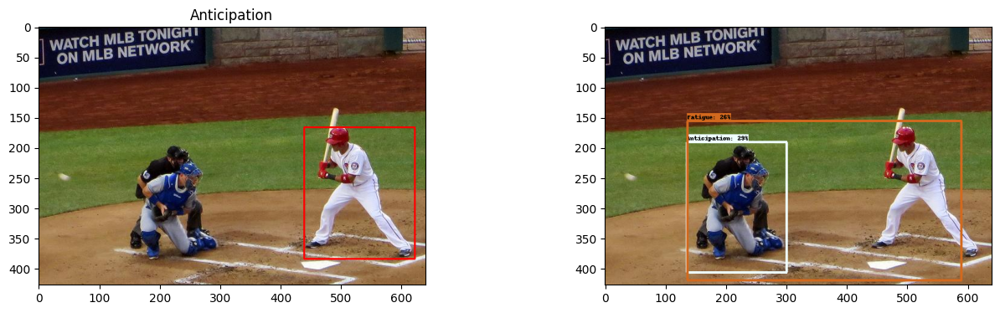

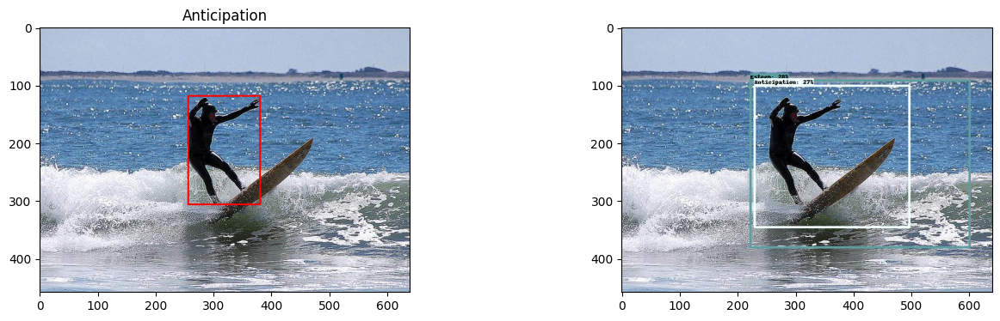

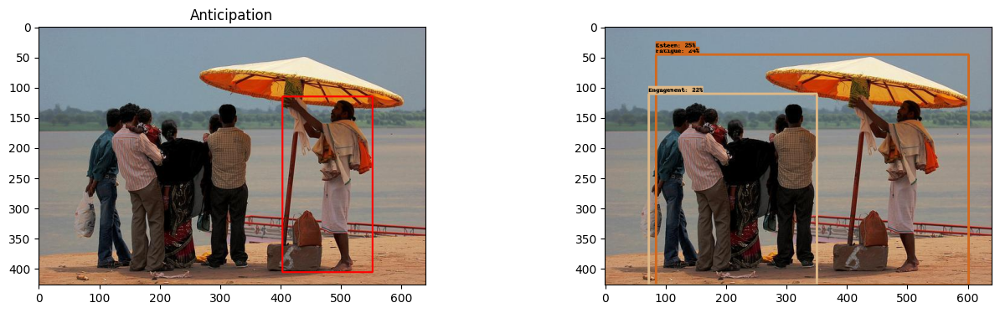

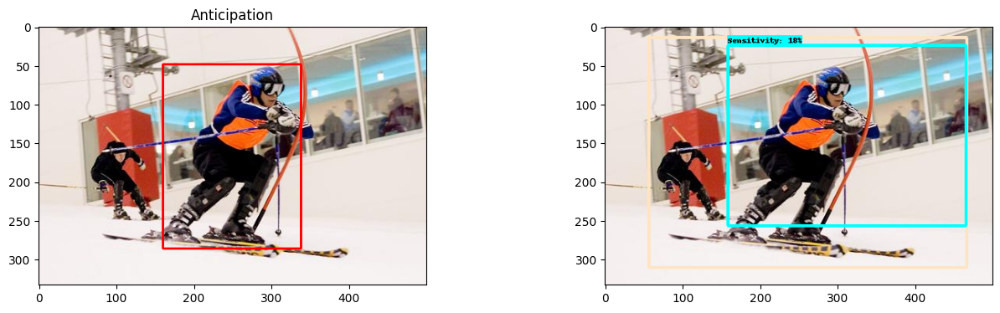

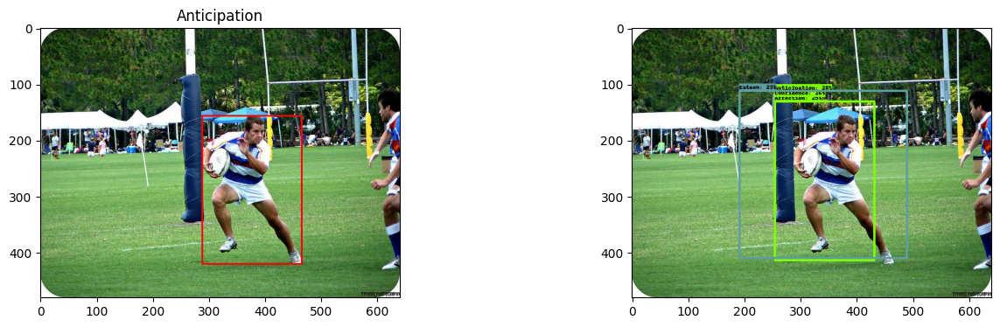

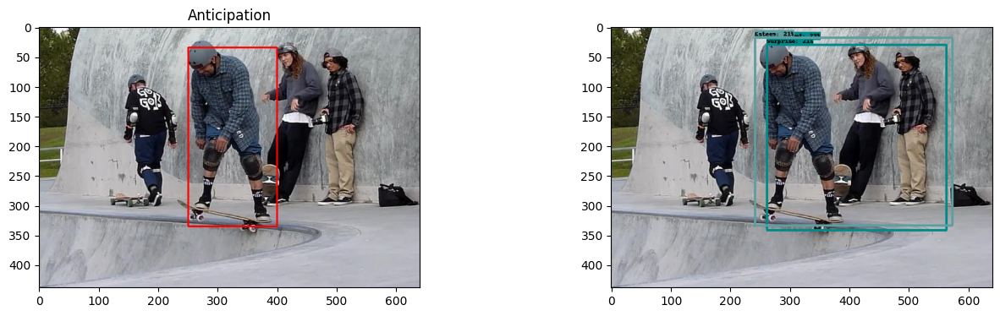

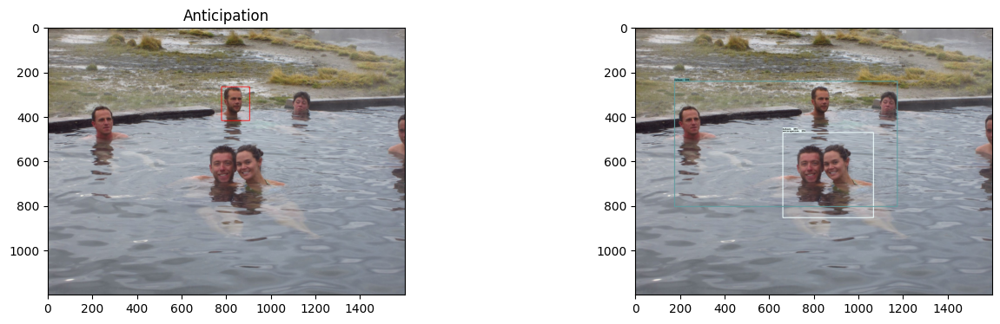

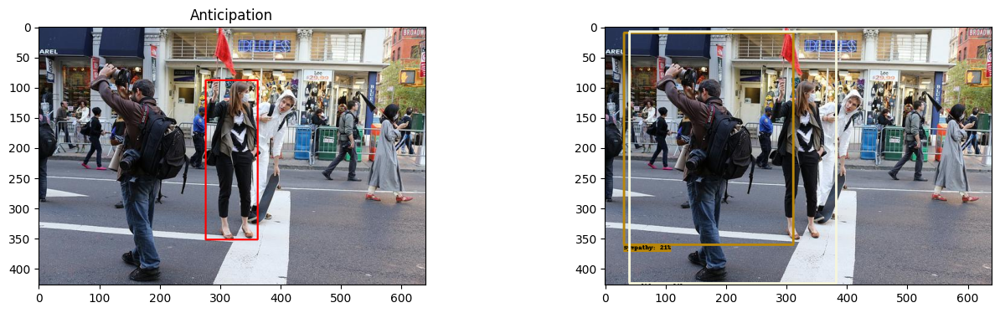

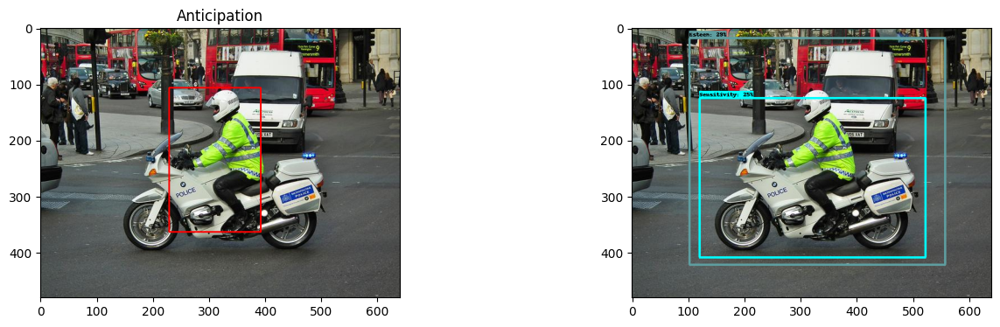

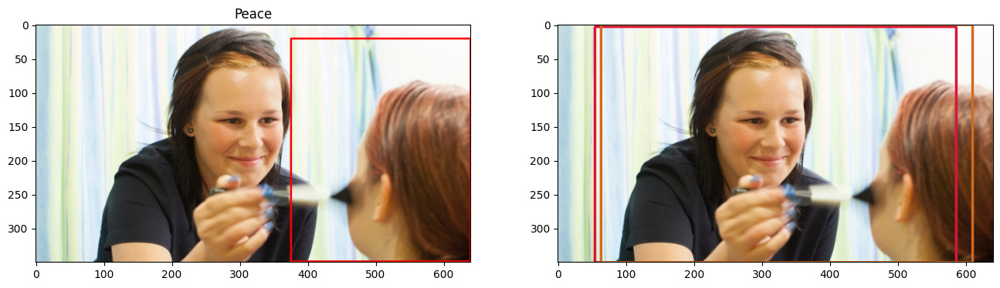

In [ ]:
for i in range(10):
  timg,labels,body = get_image_labels(df_test,i,False)
  input_tensor = tf.convert_to_tensor(timg)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis, ...]

  detections = detect_fn(input_tensor)

  image_np_with_detections = timg.copy()

  viz_utils.visualize_boxes_and_labels_on_image_array(
        image_np_with_detections,
        detections['detection_boxes'][0].numpy(),
        detections['detection_classes'][0].numpy().astype(np.int32),
        detections['detection_scores'][0].numpy(),
        category_index,
        use_normalized_coordinates=True,
        max_boxes_to_draw=2,
        min_score_thresh=0.17, # Adjust this value to set the minimum probability boxes to be classified as True
        agnostic_mode=False)

  %matplotlib inline
  plt.figure(figsize=(16,4))
  plt.subplot(1,2,1)
  plt.title(labels)
  plt.imshow(body)
  plt.subplot(1,2,2)
  plt.imshow(image_np_with_detections)
  plt.show()

[3, 28, 71, 121, 11, 7, 16, 146, 98, 8]


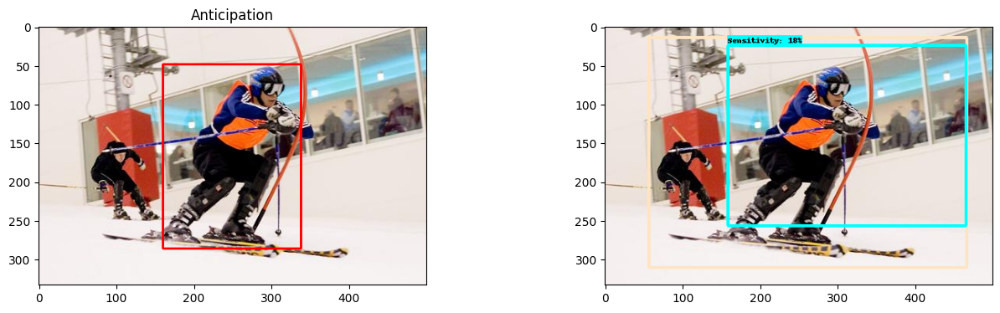

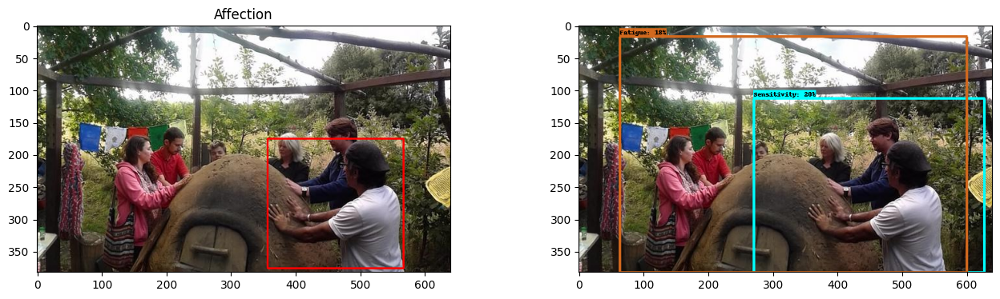

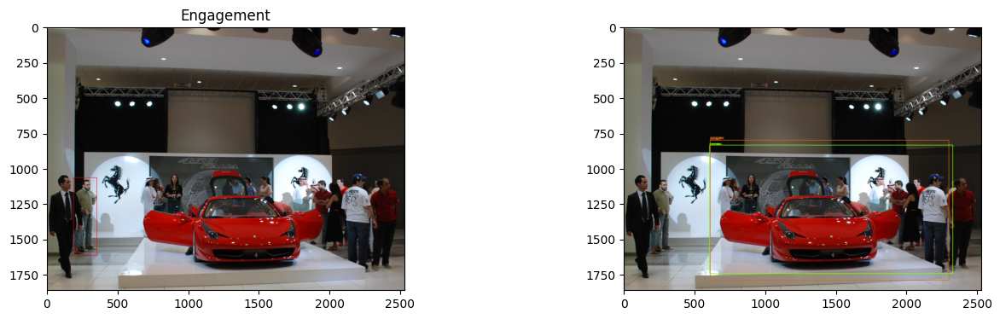

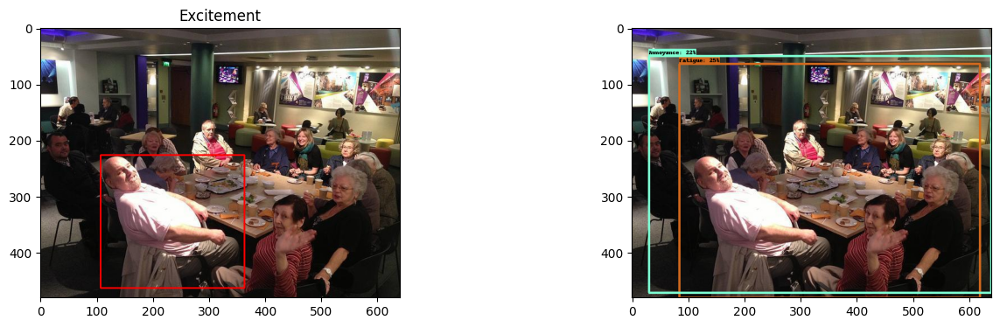

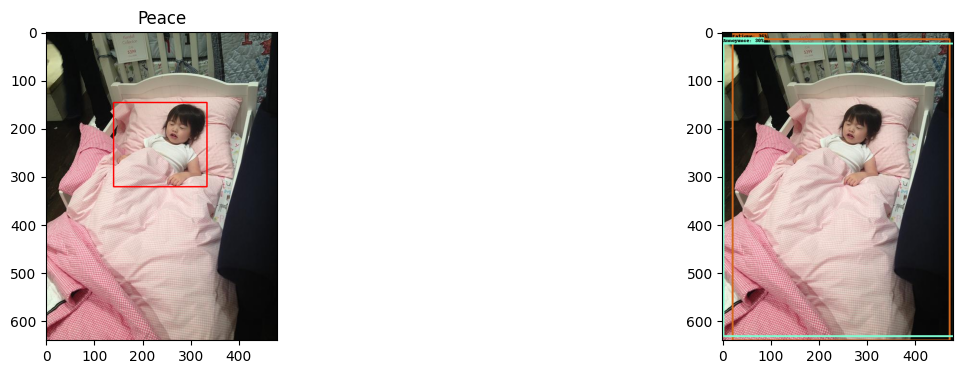

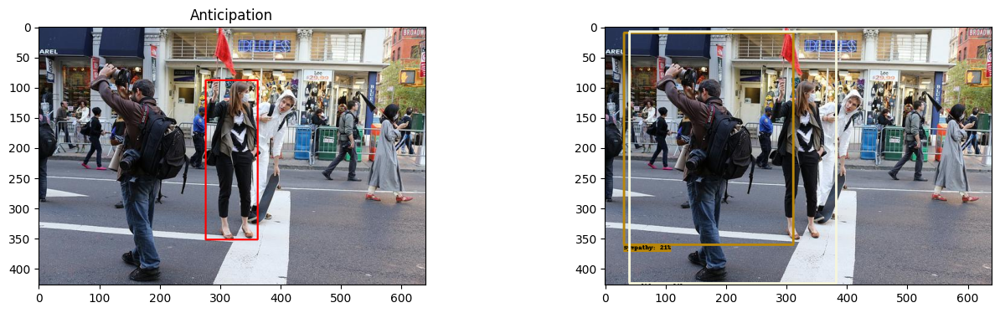

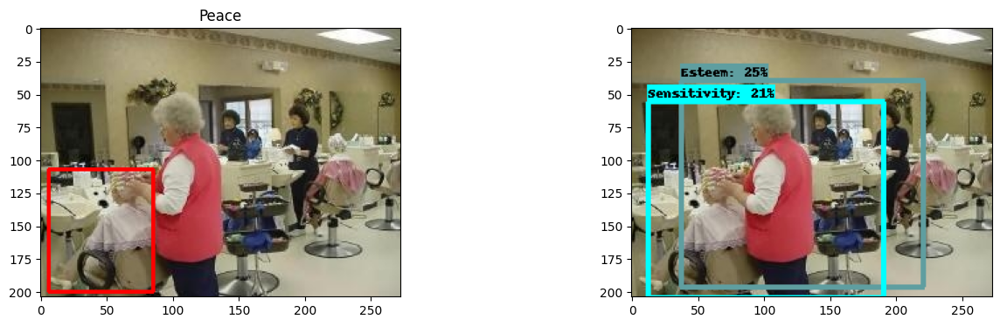

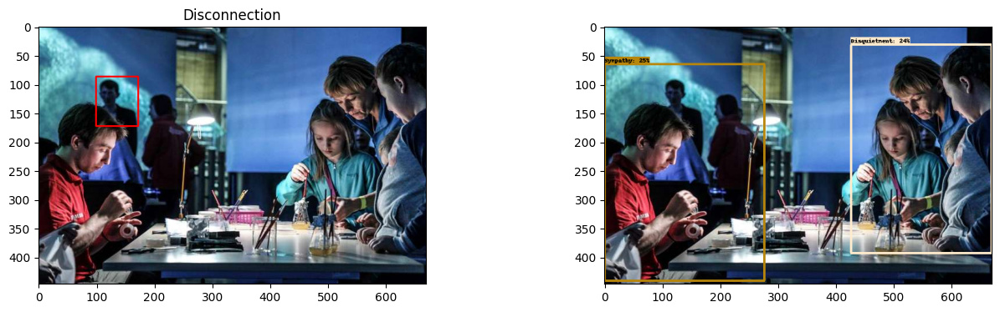

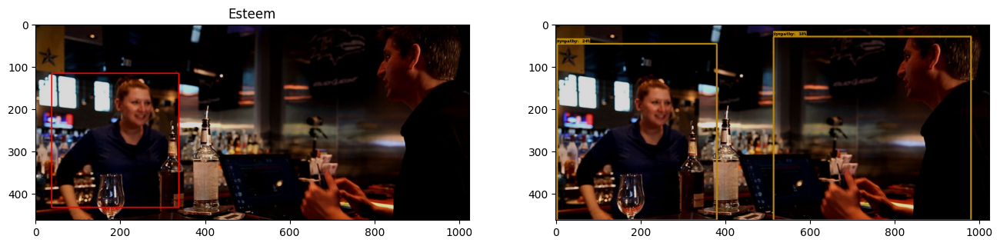

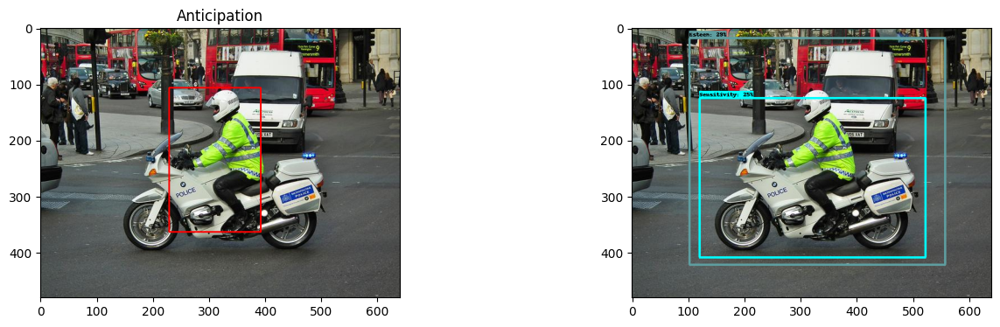

In [ ]:
iterlist = [np.random.randint(1,170) for _ in range (10)]
print(iterlist)

for i in iterlist:
  timg,labels,body = get_image_labels(df_test,i,False)
  input_tensor = tf.convert_to_tensor(timg)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis, ...]

  detections = detect_fn(input_tensor)

  image_np_with_detections = timg.copy()

  viz_utils.visualize_boxes_and_labels_on_image_array(
        image_np_with_detections,
        detections['detection_boxes'][0].numpy(),
        detections['detection_classes'][0].numpy().astype(np.int32),
        detections['detection_scores'][0].numpy(),
        category_index,
        use_normalized_coordinates=True,
        max_boxes_to_draw=2,
        min_score_thresh=0.15, # Adjust this value to set the minimum probability boxes to be classified as True
        agnostic_mode=False)

  %matplotlib inline
  plt.figure(figsize=(16,4))
  plt.subplot(1,2,1)
  plt.title(labels)
  plt.imshow(body)
  plt.subplot(1,2,2)
  plt.imshow(image_np_with_detections)
  plt.show()

In [ ]:
def plot_bboxx(i,df,img):
  nimg = img.copy()
  x1,x2,y1,y2 = df.iloc[i].values[4:8]
  bbox_body = cv2.rectangle(nimg,(x1,y1),(x2,y2),(255,0,0),2)
  return bbox_body

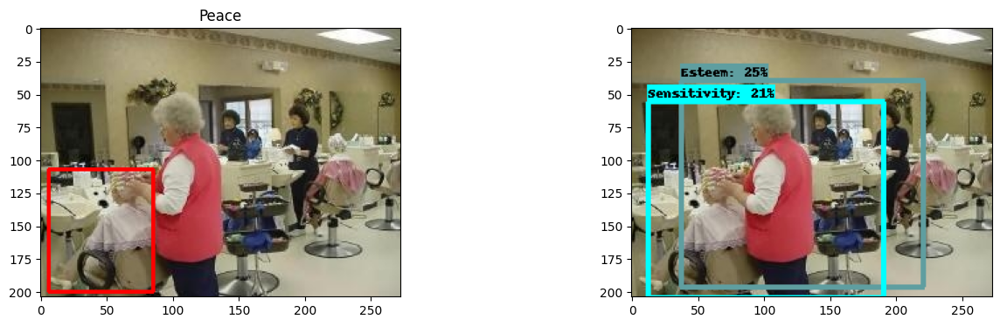

In [ ]:
timg,labels,bbox_body = get_image_labels(df_test,i,True)
input_tensor = tf.convert_to_tensor(timg)
# The model expects a batch of images, so add an axis with `tf.newaxis`.
input_tensor = input_tensor[tf.newaxis, ...]

detections = detect_fn(input_tensor)

image_np_with_detections = timg.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      detections['detection_classes'][0].numpy().astype(np.int32),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=2,
      min_score_thresh=0.17, # Adjust this value to set the minimum probability boxes to be classified as True
      agnostic_mode=False)

%matplotlib inline
plt.figure(figsize=(16,4))
plt.subplot(1,2,1)
plt.title(labels)
plt.imshow(bbox_body)
plt.subplot(1,2,2)
plt.imshow(image_np_with_detections)
plt.show()

In [ ]:
def get_colors():
  colorss = []
  for i in range(3):
    ch = [0] * 3
    ch[i] = 255
    colorss.append(ch)
  return colorss

def plot_bboxx(img,boxes):
  bbox_body = img.copy()
  colors = get_colors()
  for i,box in enumerate(boxes):
    y1,x1,y2,x2 = list(box)
    x1 = int(x1)
    x2 = int(x2)
    y1 = int(y1)
    y2 = int(y2)
    bbox_body = cv2.rectangle(bbox_body,(x1,y1),(x2,y2),colors[i],5)
  return bbox_body

def get_top_3(top_5):
  top_3 = []
  indices = []
  i=0
  while len(top_3) <3:
    if top_5[i] in top_3:
      i+=1
    else:
      top_3.append(top_5[i])
      indices.append(i)
      i+=1
  return top_3,indices

def denormalize_boxes(boxes,w,h):
  new_box = []
  for box in boxes:
    y1,x1,y2,x2 = list(box)
    new_box.append([y1*h,x1*w,y2*h,x2*w])
  return new_box

def plot_pred_img(timg,detections):
  top_5 = [cols[j-1] for j in [int(detections['detection_classes'][0][i].numpy()) for i in range(5)]]
  labels_list,indices_list = get_top_3(top_5)
  top_3_boxes = [detections['detection_boxes'][0].numpy()[i] for i in indices_list]
  h,w = df_test.iloc[i].values[2:4]
  new_boxes = denormalize_boxes(top_3_boxes,w,h)

  img = plot_bboxx(timg,new_boxes)
  plt.imshow(img)
  plt.figtext(0.65, 0.96, labels_list[0], fontsize='large', color='r', ha ='right')
  plt.figtext(0.72, 0.96, labels_list[1], fontsize='large', color='g', ha ='center')
  plt.figtext(0.78, 0.96, labels_list[2], fontsize='large', color='b', ha ='left')

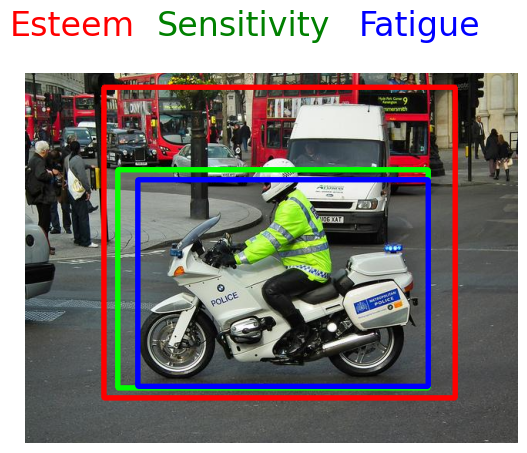

In [ ]:
i = 8
top_5 = [cols[j-1] for j in [int(detections['detection_classes'][0][i].numpy()) for i in range(5)]]
labels_list,indices_list = get_top_3(top_5)
top_3_boxes = [detections['detection_boxes'][0].numpy()[i] for i in indices_list]
h,w = df_test.iloc[i].values[2:4]
new_boxes = denormalize_boxes(top_3_boxes,w,h)

img = plot_bboxx(timg,new_boxes)
plt.imshow(img)
plt.rcParams.update({'font.size': 20})
plt.figtext(0.30, 0.96, labels_list[0], fontsize='large', color='r', ha ='right')
plt.figtext(0.47, 0.96, labels_list[1], fontsize='large', color='g', ha ='center')
plt.figtext(0.65, 0.96, labels_list[2], fontsize='large', color='b', ha ='left')
plt.axis('off')
plt.show()

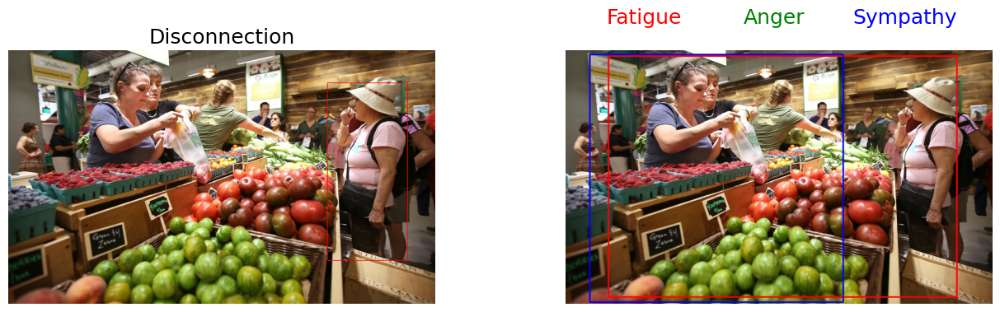

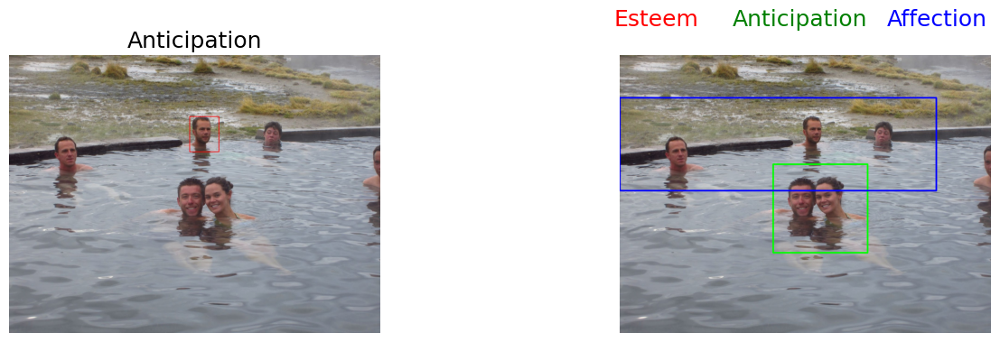

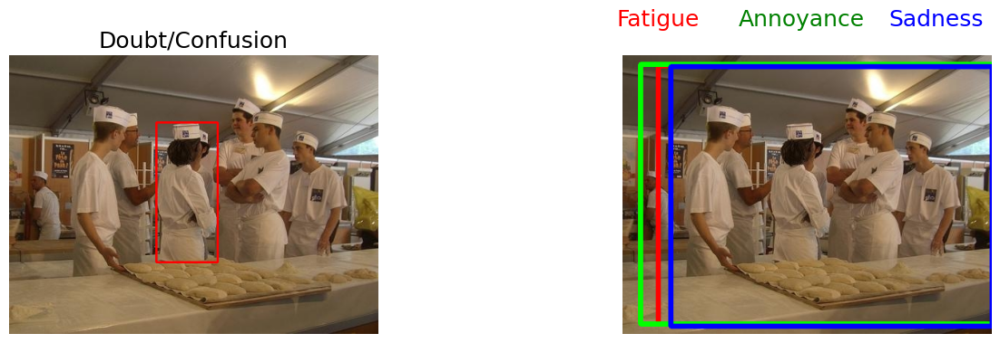

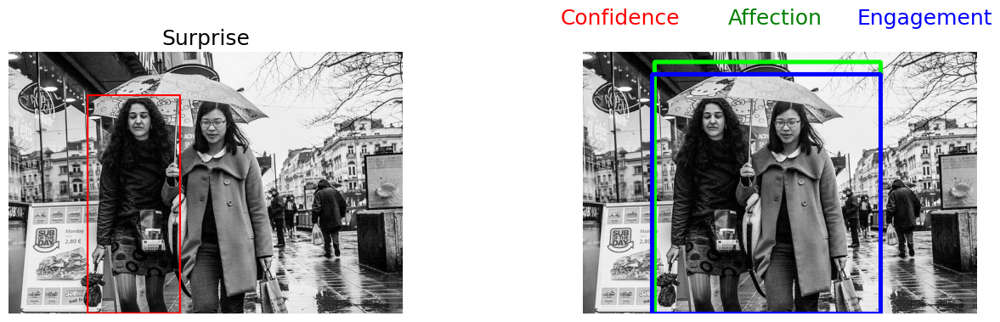

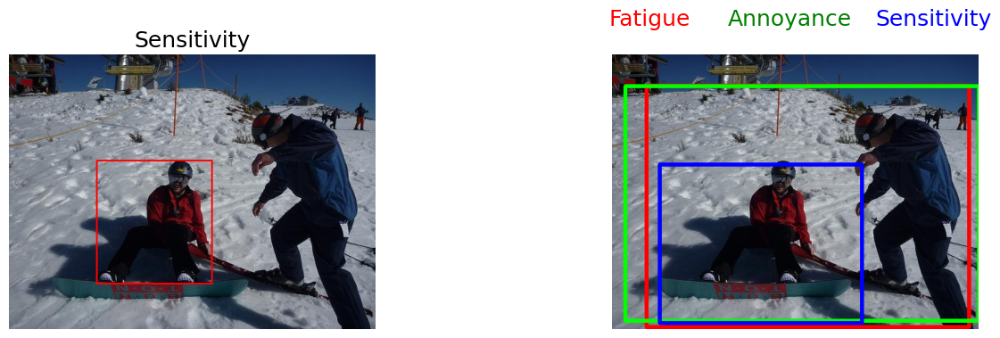

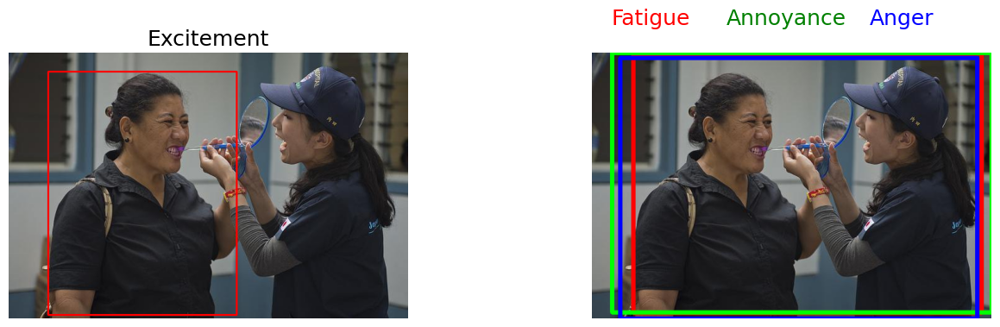

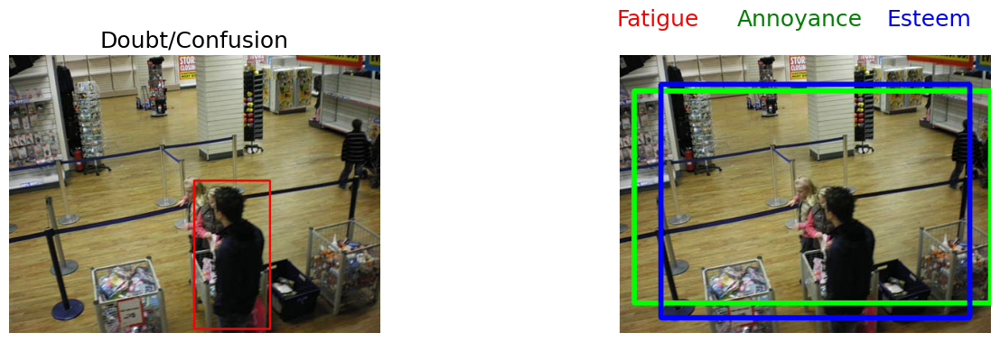

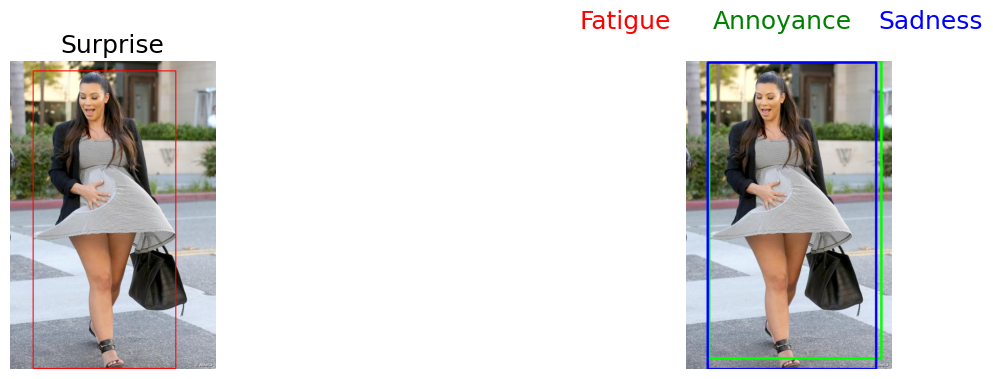

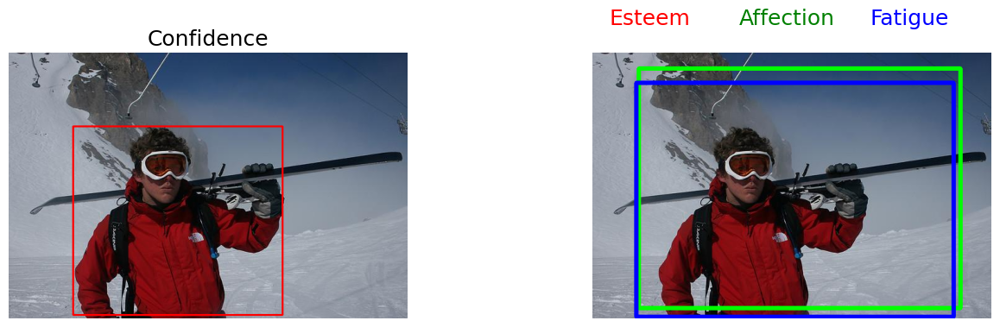

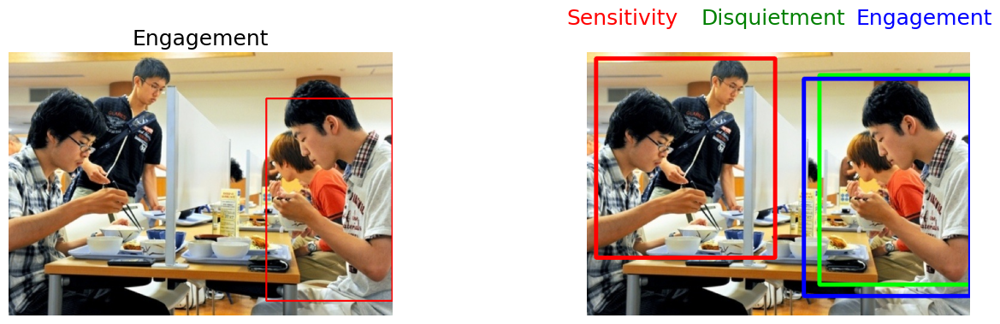

In [ ]:
# iterlist = [np.random.randint(1,170) for _ in range (10)]
iterlist = [149, 6, 101, 141, 156, 117, 106, 136, 60, 70]
# print(iterlist)

for i in iterlist:
  timg,labels,body = get_image_labels(df_test,i,False)
  input_tensor = tf.convert_to_tensor(timg)
  input_tensor = input_tensor[tf.newaxis, ...]

  detections = detect_fn(input_tensor)

  %matplotlib inline
  plt.rcParams.update({'font.size': 15})
  plt.figure(figsize=(16,4))
  plt.subplot(1,2,1)
  plt.title(labels)
  plt.axis('off')
  plt.imshow(body)
  plt.subplot(1,2,2)
  plot_pred_img(timg,detections)
  plt.axis('off')
  plt.show()